In [1]:
import numpy as np
import skimage as sk
import skimage.io as skio
from scipy.interpolate import RegularGridInterpolator
import json
import matplotlib.pyplot as plt
import scipy.signal
import scipy.ndimage
from scipy.ndimage import distance_transform_edt
import cv2
from skimage.feature import corner_harris, peak_local_max

In [2]:
def save_image(image, name):
    image = sk.exposure.rescale_intensity(image, in_range=(image.min(), image.max()), out_range=(0, 1))
    image = sk.img_as_ubyte(image)
    path = 'data/' + name + '.png'
    skio.imsave(path, image)

In [3]:
def read_correspondences(point_file):
    with open(point_file, 'r') as file:
        im_points = json.load(file) 

    # Extracting im1Points and im2Points
    im1_points = np.array(im_points["im1Points"])
    im2_points = np.array(im_points["im2Points"])
    return im1_points, im2_points

In [4]:
def crop(image, top, bottom, left, right):
    height, width = image.shape[:2]
    cropped_image = image[top:height-bottom, left:width-right]
    return cropped_image

In [5]:
def computeH(im1_pts,im2_pts):
    n = im1_pts.shape[0]
    
    # Initialize the matrix A (2n x 8) and vector b (2n x 1)
    A = []
    b = []
    
    for i in range(n):
        x, y = im1_pts[i]
        x_prime, y_prime = im2_pts[i]
        
        # Add the two equations for this pair of points
        A.append([x, y, 1, 0, 0, 0, -x_prime * x, -x_prime * y])
        A.append([0, 0, 0, x, y, 1, -y_prime * x, -y_prime * y])
        b.append(x_prime)
        b.append(y_prime)
    
    A = np.array(A)
    b = np.array(b)
    
    h, *_  = np.linalg.lstsq(A, b, rcond=None)
    
    # Reshape h to a 3x3 matrix
    H = np.append(h, 1).reshape((3, 3))
    
    return H

In [6]:
ih_pts_1, ih_pts_2 = read_correspondences('ihouse_left_ihouse_right.json')
ihouse_H = computeH(ih_pts_1, ih_pts_2)
print(ihouse_H)

[[ 2.29356215e+00 -3.90826141e-01 -5.32765032e+02]
 [ 7.97830083e-01  1.77962027e+00 -3.22812149e+02]
 [ 2.31749777e-03 -4.78142025e-04  1.00000000e+00]]


In [7]:
def calculate_output_shape(transformed_corners):
    # Calculate the Euclidean distance between all corner points
    x_vals = transformed_corners[:, 0]
    y_vals = transformed_corners[:, 1]
    # Calculate the width as the maximum horizontal distance
    width = int(np.ceil(np.max(x_vals) - np.min(x_vals)))
    # Calculate the height as the maximum vertical distance
    height = int(np.ceil(np.max(y_vals) - np.min(y_vals)))
    return height, width

In [8]:
def get_bounding(image, H):
    height, width = image.shape[:2]
    # Define corner points of the image
    corners = np.array([[0, 0], [width, 0], [width, height], [0, height]])
    corners_homogeneous = np.hstack([corners, np.ones((4, 1))])
    warped_corners = H @ corners_homogeneous.T
    warped_corners /= warped_corners[2, :]  
    
    # Extract x and y coordinates of the warped corners
    warped_x = warped_corners[0, :]
    warped_y = warped_corners[1, :]
    
    # Find the min and max x, y coordinates for the bounding box
    min_x = np.min(warped_x)
    max_x = np.max(warped_x)
    min_y = np.min(warped_y)
    max_y = np.max(warped_y)
    
    return int(np.floor(min_x)), int(np.floor(min_y)), int(np.ceil(max_x)), int(np.ceil(max_y))

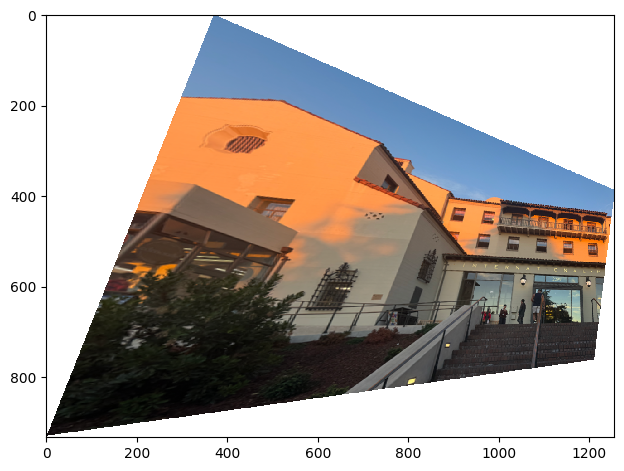

In [9]:
def warp(im, H):
    """Warp an image using a homography matrix H."""
    height, width = im.shape[:2]

    # Calculate the bounding box for the warped image
    left, top, right, bottom = get_bounding(im, H)

    # Define the output shape for the warped image
    output_shape = (int(bottom - top), int(right - left))

    x_grid, y_grid = np.meshgrid(np.arange(output_shape[1]), np.arange(output_shape[0]))
    x_grid_shifted = x_grid + left
    y_grid_shifted = y_grid + top

    # Create homogeneous coordinates for the output grid
    output_grid_homog = np.vstack([x_grid_shifted.ravel(), y_grid_shifted.ravel(), np.ones(x_grid.size)])

    # Compute the inverse homography to map points in the output image back to the input image
    H_inv = np.linalg.inv(H)
    input_grid_homog = H_inv @ output_grid_homog
    input_grid_homog /= input_grid_homog[2, :]  # Normalize by z

    # Extract corresponding input coordinates
    x_input = input_grid_homog[0, :].reshape((int(output_shape[0]), int(output_shape[1])))
    y_input = input_grid_homog[1, :].reshape((int(output_shape[0]), int(output_shape[1])))

    interpolator = RegularGridInterpolator(
        (np.arange(height), np.arange(width)),
        im,
        bounds_error=False,
        fill_value=0 
    )

    points = np.stack([y_input.ravel(), x_input.ravel()], axis=-1)
    im_warped = interpolator(points).reshape(output_shape[0], output_shape[1], im.shape[2])
    im_warped = im_warped.clip(0, 255).astype(np.uint8)
    
    return im_warped, left, top

ihouse_left = skio.imread('data/ihouse_left.png')
ihouse_right = skio.imread('data/ihouse_right.png')

ihouse_left_warped, *_ = warp(ihouse_left, ihouse_H)
save_image(ihouse_left_warped, 'ihouse_left_warped')
skio.imshow(ihouse_left_warped)
skio.show()


In [10]:
def create_square(pts):
    min_x = min(pt[0] for pt in pts)
    max_x = max(pt[0] for pt in pts)
    min_y = min(pt[1] for pt in pts)
    max_y = max(pt[1] for pt in pts)

    width = max_x - min_x
    height = max_y - min_y

    square = np.array([[0, 0],
                   [width, 0],
                   [width, height],
                   [0, height]])
    
    return square


In [11]:
def display_points_on_image(image, points):
    fig, ax = plt.subplots()
    ax.imshow(image)
    points = np.array(points)
    ax.scatter(points[:, 0], points[:, 1], c='red', s=50)
    ax.axis('off')
    plt.tight_layout()
    return fig, ax

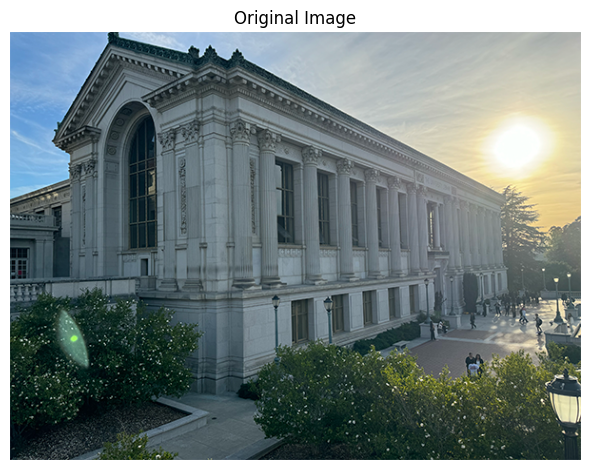

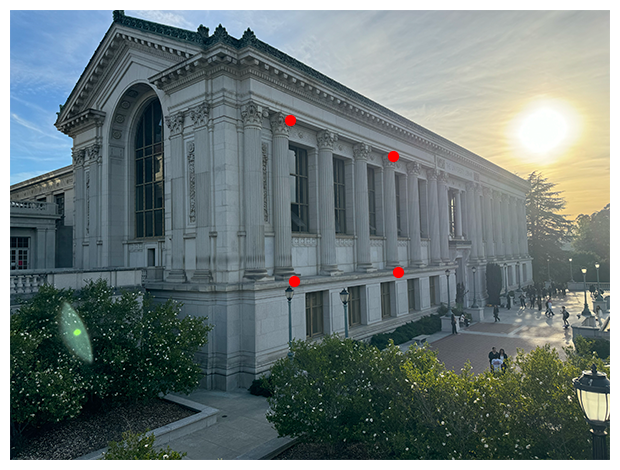

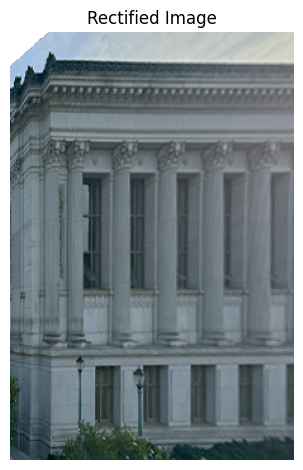

In [12]:
def rectify(im, pts, crop_margin=0.2):
    square = create_square(pts)
    H = computeH(pts, square)
    
    rectified, left, top = warp(im, H)

    pts_homog = np.column_stack([pts, np.ones(len(pts))])
    transformed_pts_homog = (H @ pts_homog.T).T
    transformed_pts = transformed_pts_homog[:, :2] / transformed_pts_homog[:, 2:]
    
    # Adjust the transformed points based on the warped image offset
    transformed_pts[:, 0] -= left
    transformed_pts[:, 1] -= top
    
    # Find the bounding box of the transformed points
    min_x, min_y = np.max([np.min(transformed_pts, axis=0), [0, 0]], axis=0).astype(int)
    max_x, max_y = np.min([np.max(transformed_pts, axis=0), rectified.shape[1::-1]], axis=0).astype(int)
    
    # Calculate margin based on percentage
    x_margin = max(int((max_x - min_x) * crop_margin), 20)
    y_margin = max(int((max_y - min_y) * crop_margin), 20)
    
    # Add margin to bounding box
    min_x = max(0, min_x - x_margin)
    min_y = max(0, min_y - y_margin)
    max_x = min(rectified.shape[1] - 1, max_x + x_margin)
    max_y = min(rectified.shape[0] - 1, max_y + y_margin)

    # Crop the warped image
    rectified_cropped = rectified[min_y:max_y+1, min_x:max_x+1]
        
    fig, ax = plt.subplots()
    ax.imshow(im)
    ax.set_title("Original Image")
    ax.axis('off')
    fig.tight_layout()
    plt.show()

    display_points_on_image(im, pts)

    fig, ax = plt.subplots()
    ax.imshow(rectified_cropped)
    ax.set_title("Rectified Image")
    ax.axis('off')
    fig.tight_layout()
    plt.show()

    return rectified_cropped.clip(0, 255).astype(int)

doe = skio.imread('data/doe.png')
doe_pts, _ = read_correspondences('doe_doe.json')
doe_rectified = rectify(doe, doe_pts, crop_margin=0.55)
save_image(doe_rectified, 'doe_rectified')

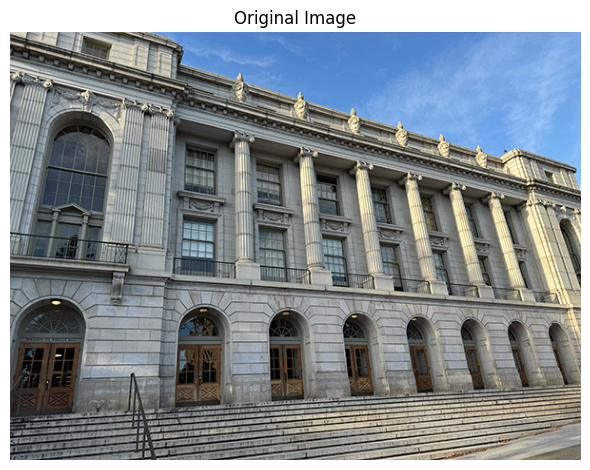

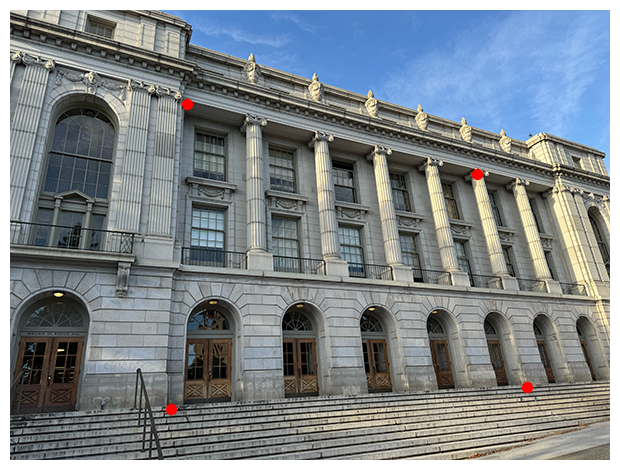

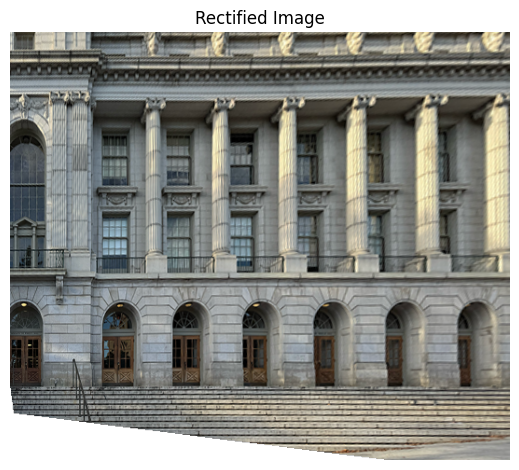

In [13]:
wheeler = skio.imread('data/wheeler.png')
wheeler_pts, _ = read_correspondences('wheeler_wheeler.json')
wheeler_rectified = rectify(wheeler, wheeler_pts, crop_margin=0.25)
save_image(wheeler_rectified, 'wheeler_rectified')

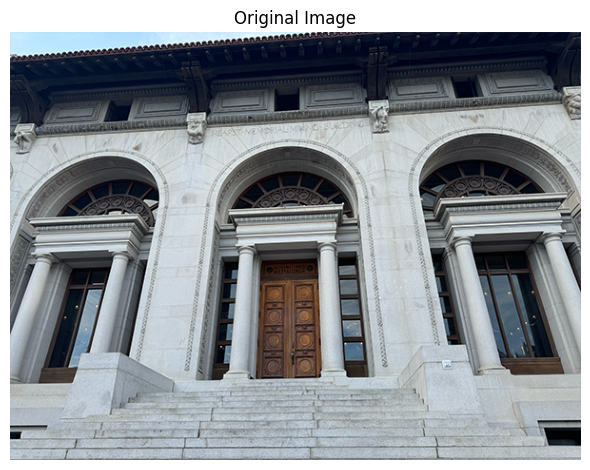

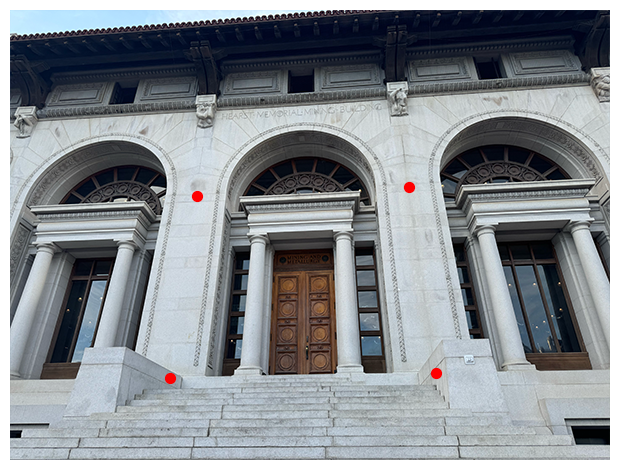

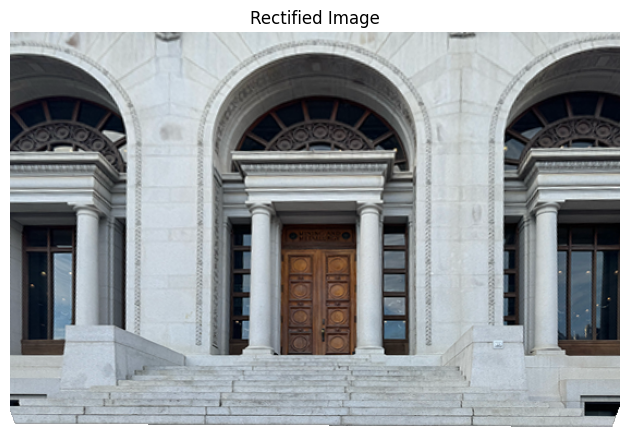

In [14]:
hearst_mining = skio.imread('data/hearst_mining.png')
hearst_mining_pts, _ = read_correspondences('hearst_mining_hearst_mining.json')
hearst_mining_rectified = rectify(hearst_mining, hearst_mining_pts, crop_margin=0.55)
save_image(hearst_mining_rectified, 'hearst_mining_rectified')

In [15]:
def apply_gaussian(image, kernel_size, sigma):
    one_d_gaussian = cv2.getGaussianKernel(kernel_size, sigma)
    gaussian_kernel = np.outer(one_d_gaussian, one_d_gaussian.transpose())
    return scipy.signal.convolve2d(image, gaussian_kernel, mode='same', boundary='symm')

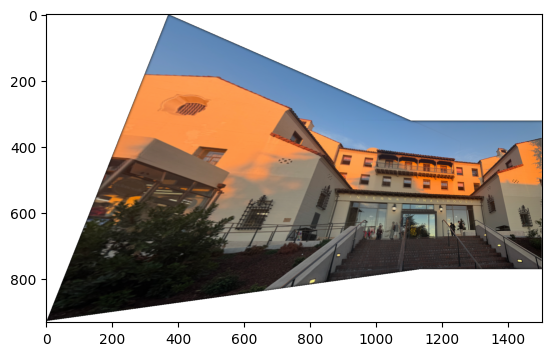

In [16]:
def blend_images(image1, image2, H, sigma=4):
    warped_img1, *_ = warp(image1, H)
    
    # Get dimensions and compute bounding box
    height_img1, width_img1 = warped_img1.shape[:2]
    height_img2, width_img2 = image2.shape[:2]
    min_x1, min_y1, max_x1, max_y1 = get_bounding(image1, H)
    
    # Determine overall bounding box for the mosaic
    min_x = min(0, min_x1)
    max_x = max(width_img2, max_x1)
    min_y = min(0, min_y1)
    max_y = max(height_img2, max_y1)
    
    # Canvas size
    new_height, new_width = int(max_y - min_y), int(max_x - min_x)
    
    # Initialize canvases
    blended_img1 = np.zeros((new_height, new_width, 4))
    blended_img2 = np.zeros((new_height, new_width, 4))
    
    # Place images on canvases
    img1_x_start, img1_y_start = int(min_x1 - min_x), int(min_y1 - min_y)
    img2_x_start, img2_y_start = int(-min_x), int(-min_y)
    blended_img1[img1_y_start:img1_y_start+height_img1, img1_x_start:img1_x_start+width_img1] = warped_img1
    blended_img2[img2_y_start:img2_y_start+height_img2, img2_x_start:img2_x_start+width_img2] = image2

    # Create masks
    mask1 = blended_img1[:,:,3] 
    mask2 = blended_img2[:,:,3] 

    # Compute and normalize distance transforms
    d1 = distance_transform_edt(mask1)
    d2 = distance_transform_edt(mask2)
    d_sum = d1 + d2
    d1 = d1 / np.maximum(d_sum, 1e-6)
    d2 = d2 / np.maximum(d_sum, 1e-6)

    # Apply Gaussian smoothing to weights\
    d1 = apply_gaussian(d1, int(6 * sigma + 1), sigma)
    d2 = apply_gaussian(d2, int(6 * sigma + 1), sigma)

    # Blend images
    blended_result = d1[:,:,np.newaxis] * blended_img1 + d2[:,:,np.newaxis] * blended_img2

    # Ensure alpha channel is the maximum of both images
    blended_result[:,:,3] = np.maximum(blended_img1[:,:,3], blended_img2[:,:,3])

    # Clip and convert to uint8
    blended_result = blended_result.clip(0, 255).astype(np.uint8)
    
    return blended_result


ihouse_mosaic = blend_images(ihouse_left, ihouse_right, ihouse_H)
save_image(ihouse_mosaic, 'ihouse_mosaic')

plt.imshow(ihouse_mosaic)
plt.show()


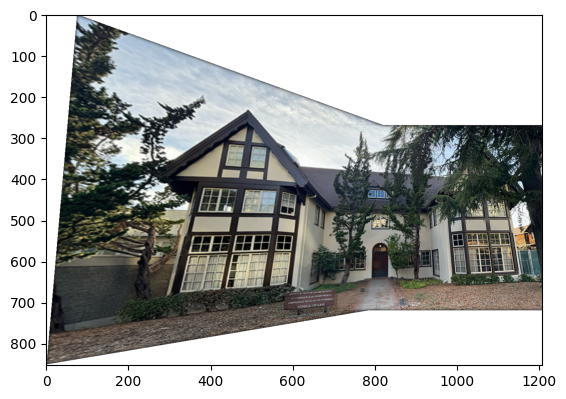

In [17]:
law_left = skio.imread('data/law_left.png')
law_right = skio.imread('data/law_right.png')
law_left_pts, law_right_pts = read_correspondences('law_left_law_right.json')
law_H = computeH(law_left_pts, law_right_pts)

law_mosaic = blend_images(law_left, law_right, law_H)
save_image(law_mosaic, 'law_mosaic')

plt.imshow(law_mosaic)
plt.show()

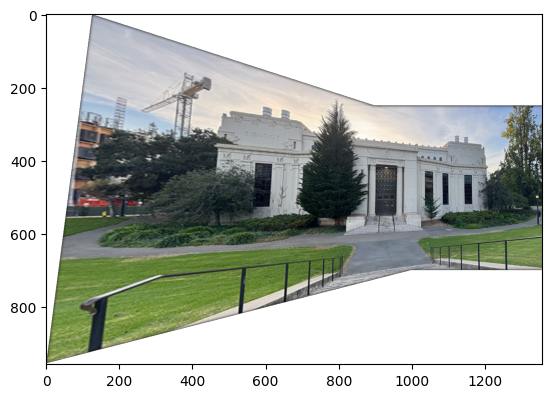

In [18]:
vlsb_left = skio.imread('data/vlsb_left.png')
vlsb_right = skio.imread('data/vlsb_right.png')
vlsb_left_pts, vlsb_right_pts = read_correspondences('vlsb_left_vlsb_right.json')
vlsb_H = computeH(vlsb_left_pts, vlsb_right_pts)

vlsb_mosaic = blend_images(vlsb_left, vlsb_right, vlsb_H)
save_image(vlsb_mosaic, 'vlsb_mosaic')

plt.imshow(vlsb_mosaic)
plt.show()

In [19]:

def get_harris_corners(im, edge_discard=20):
    """
    This function takes a b&w image and an optional amount to discard
    on the edge (default is 5 pixels), and finds all harris corners
    in the image. Harris corners near the edge are discarded and the
    coordinates of the remaining corners are returned. A 2d array (h)
    containing the h value of every pixel is also returned.

    h is the same shape as the original image, im.
    coords is 2 x n (ys, xs).
    """

    assert edge_discard >= 20

    # find harris corners
    h = corner_harris(im, method='eps', sigma=1)
    coords = peak_local_max(h, min_distance=1)

    # discard points on edge
    edge = edge_discard  # pixels
    mask = (coords[:, 0] > edge) & \
           (coords[:, 0] < im.shape[0] - edge) & \
           (coords[:, 1] > edge) & \
           (coords[:, 1] < im.shape[1] - edge)
    coords = coords[mask].T
    return h, coords


def dist2(x, c):
    """
    dist2  Calculates squared distance between two sets of points.

    Description
    D = DIST2(X, C) takes two matrices of vectors and calculates the
    squared Euclidean distance between them.  Both matrices must be of
    the same column dimension.  If X has M rows and N columns, and C has
    L rows and N columns, then the result has M rows and L columns.  The
    I, Jth entry is the  squared distance from the Ith row of X to the
    Jth row of C.

    Adapted from code by Christopher M Bishop and Ian T Nabney.
    """
    
    ndata, dimx = x.shape
    ncenters, dimc = c.shape
    assert(dimx == dimc, 'Data dimension does not match dimension of centers')

    return (np.ones((ncenters, 1)) * np.sum((x**2).T, axis=0)).T + \
            np.ones((   ndata, 1)) * np.sum((c**2).T, axis=0)    - \
            2 * np.inner(x, c)


<>:46: SyntaxWarning: assertion is always true, perhaps remove parentheses?
<>:46: SyntaxWarning: assertion is always true, perhaps remove parentheses?
/var/folders/mn/53zmtyxn6636vw6p7_xh5n9m0000gn/T/ipykernel_49392/160098996.py:46: SyntaxWarning: assertion is always true, perhaps remove parentheses?
  assert(dimx == dimc, 'Data dimension does not match dimension of centers')


In [20]:
def plot_points_over_image(img, coords, point_color='deepskyblue', point_size=10):
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.scatter(coords[1], coords[0], c=point_color, s=point_size, edgecolor='black')
    ax.axis('off')
    fig.subplots_adjust(left=0, right=1, top=1, bottom=0) 
    fig.patch.set_visible(False) 
    ax.margins(0)  
    plt.show()

In [21]:
ihouse_left_color = skio.imread('data/ihouse_left.png')
ihouse_left_color = sk.color.rgba2rgb(ihouse_left_color)
ihouse_right_color = skio.imread('data/ihouse_right.png')
ihouse_right_color = sk.color.rgba2rgb(ihouse_right_color)

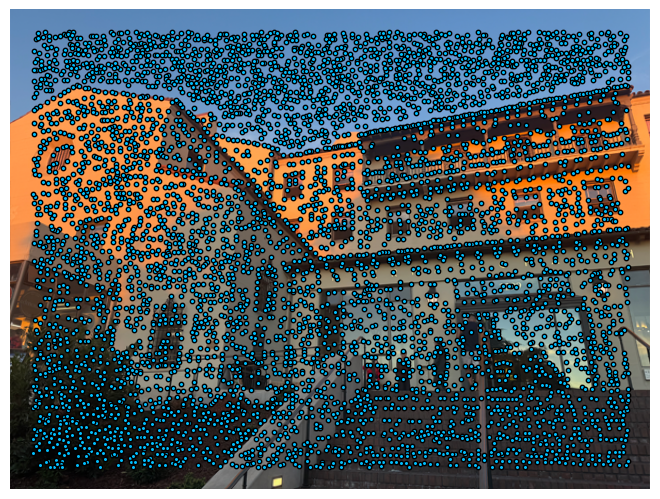

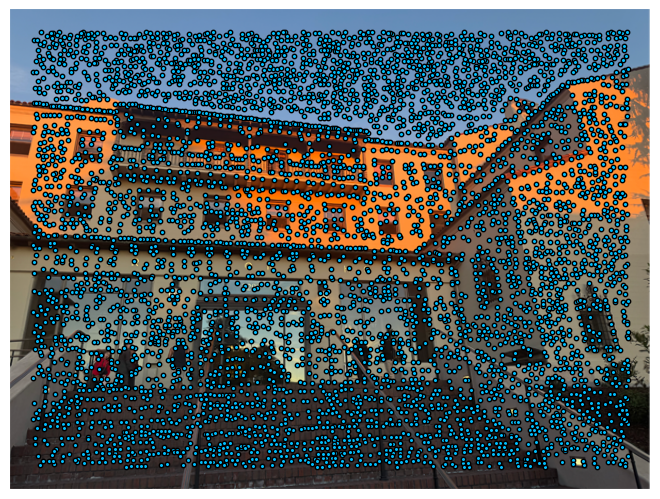

In [22]:
ihouse_left = skio.imread('data/ihouse_left.png')
ihouse_left = sk.color.rgba2rgb(ihouse_left)
ihouse_left = sk.color.rgb2gray(ihouse_left)
ihouse_left_h, ihouse_left_coords = get_harris_corners(ihouse_left)
plot_points_over_image(ihouse_left_color, ihouse_left_coords)
ihouse_right = skio.imread('data/ihouse_right.png')
ihouse_right = sk.color.rgba2rgb(ihouse_right)
ihouse_right = sk.color.rgb2gray(ihouse_right)
ihouse_right_h, ihouse_right_coords = get_harris_corners(ihouse_right)
plot_points_over_image(ihouse_right_color, ihouse_right_coords)

In [23]:
def anms(coords, h_values, c_robust=0.9, num_points=500):
    coords_t = coords.T 

    corner_strengths = np.array([h_values[y, x] for y, x in coords_t])
    N = coords.shape[1]
    radii = np.zeros(N)
    
    
    for i in range(N):
        current_strength = corner_strengths[i]
        stronger_corners = corner_strengths > current_strength / c_robust
        
        if np.any(stronger_corners):
            # Calculate distances to stronger corners
            distances = np.sqrt(np.sum((coords_t[stronger_corners] - coords_t[i])**2, axis=1))
            radii[i] = np.min(distances)
        else:
            # If no stronger corners exist, set radius to a large value
            radii[i] = np.inf
            
    # Sort corners by radius (descending) and select top num_points
    idx = np.argsort(-radii)
    if num_points < len(idx):
        idx = idx[:num_points]
    
    return coords[:, idx]

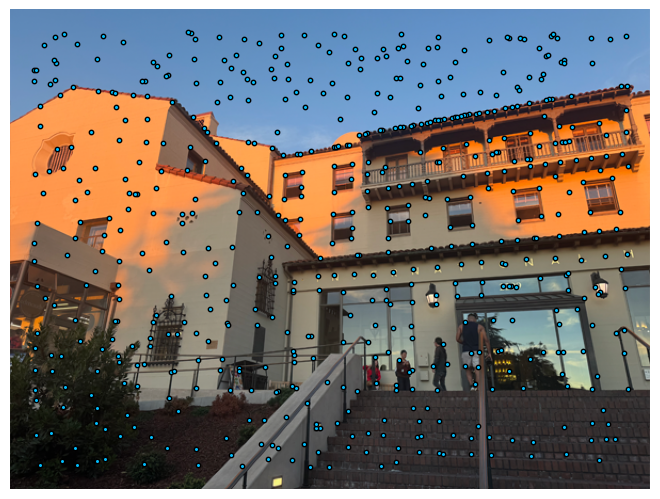

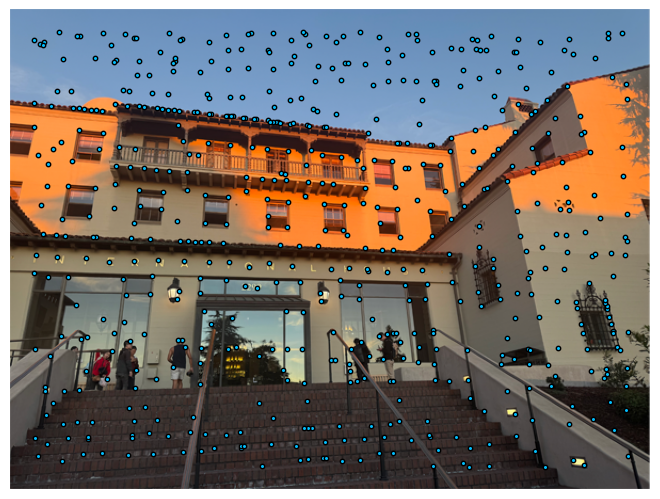

In [24]:
ihouse_left_anms = anms(ihouse_left_coords, ihouse_left_h, num_points=600)
plot_points_over_image(ihouse_left_color, ihouse_left_anms)
ihouse_right_anms = anms(ihouse_right_coords, ihouse_right_h, num_points=600)
plot_points_over_image(ihouse_right_color, ihouse_right_anms)

In [25]:
def extract_descriptors(image, corners, patch_size=8, window_size=40):
    # Reshape corners from (2, 500) to (500, 2) format
    corners = corners.T  # Transpose from (2, 500) to (500, 2)
    
    descriptors = []
    spacing = window_size // patch_size 
    half_window = window_size // 2
    
    skipped_corners = 0
    
    for corner in corners:
        y, x = int(corner[0]), int(corner[1])
        
        # Skip corners too close to the boundary
        if (x < half_window or x >= image.shape[1] - half_window or 
            y < half_window or y >= image.shape[0] - half_window):
            skipped_corners += 1
            continue
            
        # Extract large window around corner
        window = image[y - half_window:y + half_window,
                      x - half_window:x + half_window]
        
        # Sample patch_size x patch_size points with spacing
        patch = window[::spacing, ::spacing][:patch_size, :patch_size]
        
        # Flatten patch to create descriptor
        descriptor = patch.flatten()
        
        # Bias/gain normalization (zero mean, unit standard deviation)
        descriptor = (descriptor - np.mean(descriptor)) / (np.std(descriptor))
        descriptors.append(descriptor)
    
    return np.array(descriptors)

extract_descriptors(ihouse_left, ihouse_left_anms)

array([[ 1.38108779,  1.37775829,  1.39651154, ..., -0.93858775,
        -1.01117174, -0.79794836],
       [ 0.72288725,  0.40642582, -0.19548859, ...,  1.05882106,
         1.15014802,  1.19426305],
       [ 1.0443734 ,  1.16653864,  0.52918305, ..., -0.92843294,
         0.72550212,  1.13761423],
       ...,
       [ 1.10343417,  1.07727309, -0.91705421, ...,  0.74444598,
         0.64683914, -0.9668215 ],
       [-0.18237731,  0.1450333 ,  0.59454008, ...,  0.95182299,
        -1.51360722, -2.05031451],
       [ 0.25258168,  0.23672103,  0.26111283, ..., -1.64573227,
         0.62554536,  0.57426619]])

In [26]:
def match_features(descriptors1, descriptors2, ratio_threshold=0.5):
    matches = []
    distances = dist2(descriptors1, descriptors2)

    # For each descriptor in the first image
    for i in range(len(descriptors1)):        
        # Find indices of two closest matches
        curr_dist = distances[i]
        match_idx = curr_dist.argmin()
        
        sorted_idx = np.argsort(curr_dist)
        best_idx = sorted_idx[0]
        second_best_idx = sorted_idx[1]
        
        # Compute ratio between closest and second closest
        ratio = curr_dist[best_idx] / curr_dist[second_best_idx]
        
        # If ratio is less than threshold, consider it a match
        if ratio < ratio_threshold:
            matches.append((i, match_idx))
            
    return np.array(matches)

In [27]:
def visualize_matches(image1, image2, corners1, corners2, matches, 
                     line_color='deepskyblue', point_color='gold', 
                     line_width=1.0, point_size=5,
                     line_alpha=0.7, point_alpha=1.0):
    fig, ax = plt.subplots(figsize=(15, 8))
    
    # Get dimensions
    h1, w1 = image1.shape[:2]
    h2, w2 = image2.shape[:2]
    
    # Create composite image
    composite_img = np.zeros((max(h1, h2), w1 + w2, 3))
    
    # Normalize images if they're not already
    image1_norm = image1.astype(float) / 255.0 if image1.max() > 1.0 else image1
    image2_norm = image2.astype(float) / 255.0 if image2.max() > 1.0 else image2
    
    # Add images to composite
    composite_img[:h1, :w1] = image1_norm
    composite_img[:h2, w1:w1+w2] = image2_norm
    
    # Display composite image
    ax.imshow(composite_img)
    
    # Plot matches
    for idx1, idx2 in matches:
        # Get coordinates
        y1, x1 = corners1[:, idx1]
        y2, x2 = corners2[:, idx2]
        
        # Adjust x-coordinate for second image
        x2 = x2 + w1
        
        # Draw line
        ax.plot([x1, x2], [y1, y2], 
                color=line_color, linewidth=line_width, alpha=line_alpha)
        
        # Plot points
        ax.plot(x1, y1, 'o', color=point_color, 
                markersize=point_size, alpha=point_alpha)
        ax.plot(x2, y2, 'o', color=point_color, 
                markersize=point_size, alpha=point_alpha)
    
    ax.axis('off')
    fig.subplots_adjust(left=0, right=1, top=1, bottom=0)  # Remove all borders
    fig.patch.set_visible(False)  # Remove background
    plt.show()

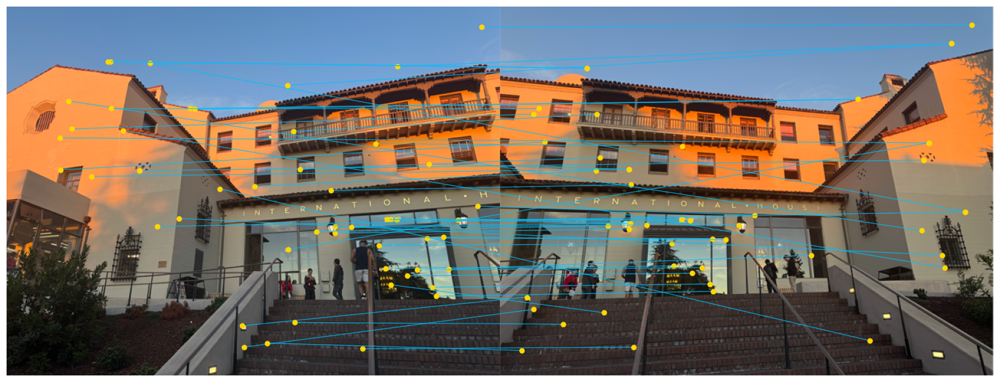

In [28]:
ihouse_left_descriptors = extract_descriptors(ihouse_left, ihouse_left_anms)
ihouse_right_descriptors = extract_descriptors(ihouse_right, ihouse_right_anms)

ihouse_matches = match_features(ihouse_left_descriptors, ihouse_right_descriptors, ratio_threshold=0.7)
visualize_matches(ihouse_left_color, ihouse_right_color, ihouse_left_anms, ihouse_right_anms, ihouse_matches)

In [29]:
def ransac(feature_matches, src_keypoints, dst_keypoints, max_iterations=10000, inlier_threshold=1):
    feature_matches = np.array(feature_matches)
    
    # Ensure keypoints are in (N, 2) format for consistency
    src_keypoints = src_keypoints.T if src_keypoints.shape[0] == 2 else src_keypoints
    dst_keypoints = dst_keypoints.T if dst_keypoints.shape[0] == 2 else dst_keypoints

    # Filter valid matches based on bounds of keypoints arrays
    valid_matches = [
        match for match in feature_matches
        if match[0] < src_keypoints.shape[0] and match[1] < dst_keypoints.shape[0]
    ]
    feature_matches = np.array(valid_matches)

    if feature_matches.shape[0] < 4:
        raise ValueError("Not enough matches to compute homography.")

    best_inliers = []
    max_inlier_count = 0

    for _ in range(max_iterations):
        selected_indices = np.random.choice(feature_matches.shape[0], 4, replace=False)
        selected_matches = feature_matches[selected_indices]

        src_points_sample = src_keypoints[selected_matches[:, 0]]
        dst_points_sample = dst_keypoints[selected_matches[:, 1]]

        homography_matrix = computeH(src_points_sample, dst_points_sample)
        if homography_matrix is None:
            continue

        inliers = []
        for match in feature_matches:
            src_idx, dst_idx = match
            if src_idx >= src_keypoints.shape[0] or dst_idx >= dst_keypoints.shape[0]:
                continue  # Skip if indices are out of bounds

            src_point = src_keypoints[src_idx]
            dst_point = dst_keypoints[dst_idx]
            transformed = homography_matrix @ np.array([src_point[0], src_point[1], 1])
            transformed_x, transformed_y = transformed[:2] / transformed[2]  # Normalize
            
            dst_x, dst_y = dst_point
            if np.sqrt((dst_x - transformed_x) ** 2 + (dst_y - transformed_y) ** 2) < inlier_threshold:
                inliers.append(match)

        if len(inliers) > max_inlier_count:
            max_inlier_count = len(inliers)
            best_inliers = inliers

    best_inliers = np.array(best_inliers)
    if best_inliers.size == 0:
        return None, []
    
    best_src_points = np.flip(src_keypoints[best_inliers[:, 0]])
    best_dst_points = np.flip(dst_keypoints[best_inliers[:, 1]])
    best_homography = computeH(best_src_points, best_dst_points)
    return best_homography, best_inliers 


In [30]:
def auto_morph(left_im_path, right_im_path, inlier_threshold=1, ratio_threshold=0.8):
    left_im_rgba = skio.imread(left_im_path)
    left_im_color = sk.color.rgba2rgb(left_im_rgba)
    left_im = sk.color.rgb2gray(left_im_color)
    left_im_h, left_im_coords = get_harris_corners(left_im)
    plot_points_over_image(left_im_color, left_im_coords)
    left_im_corners = anms(left_im_coords, left_im_h)
    plot_points_over_image(left_im_color, left_im_corners)
    left_im_descriptors = extract_descriptors(left_im, left_im_corners)

    right_im_rgba = skio.imread(right_im_path)
    right_im_color = sk.color.rgba2rgb(right_im_rgba)
    right_im = sk.color.rgb2gray(right_im_color)
    right_im_h, right_im_coords = get_harris_corners(right_im)
    plot_points_over_image(right_im_color, right_im_coords)
    right_im_corners = anms(right_im_coords, right_im_h)
    plot_points_over_image(right_im_color, right_im_corners)
    right_im_descriptors = extract_descriptors(right_im, right_im_corners)

    matches = match_features(left_im_descriptors, right_im_descriptors, ratio_threshold=ratio_threshold)
    visualize_matches(left_im_color, right_im_color, left_im_corners,
                    right_im_corners, matches)
    H, inliers = ransac(matches, left_im_corners, right_im_corners, max_iterations=10000, inlier_threshold=inlier_threshold)
    visualize_matches(left_im_color, right_im_color, left_im_corners, right_im_corners, inliers)
    return blend_images(left_im_rgba, right_im_rgba, H)



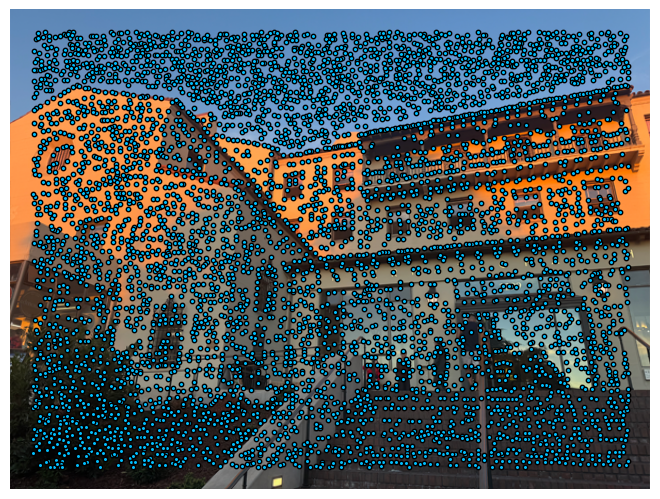

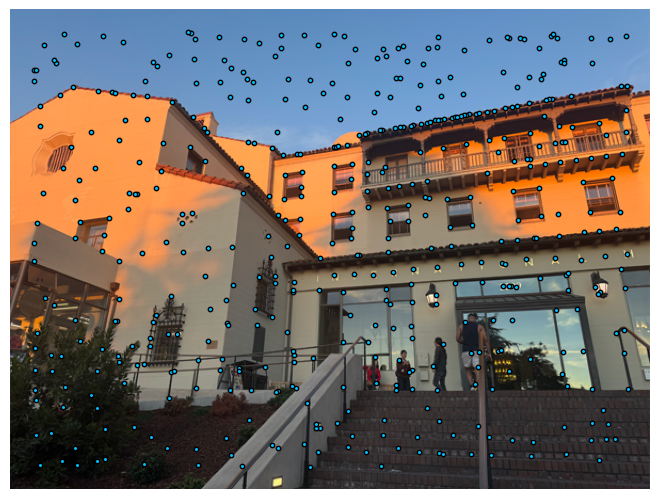

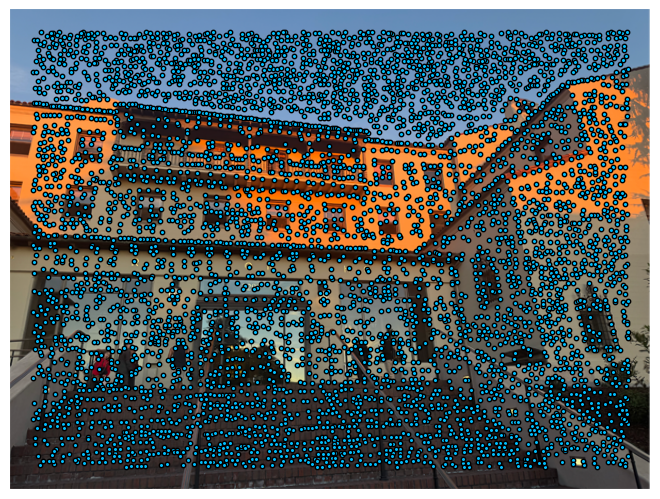

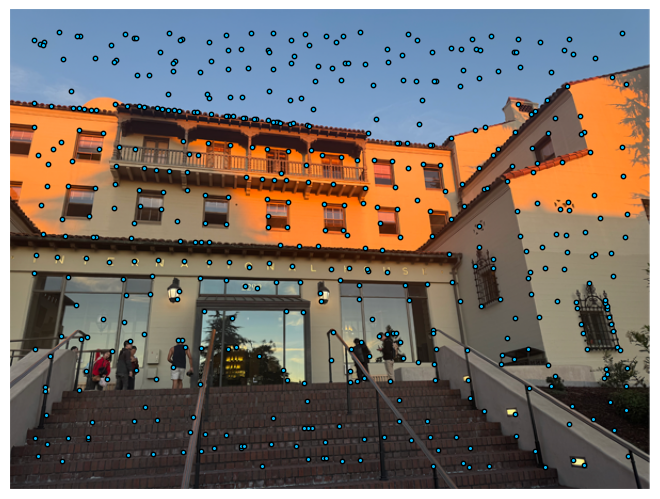

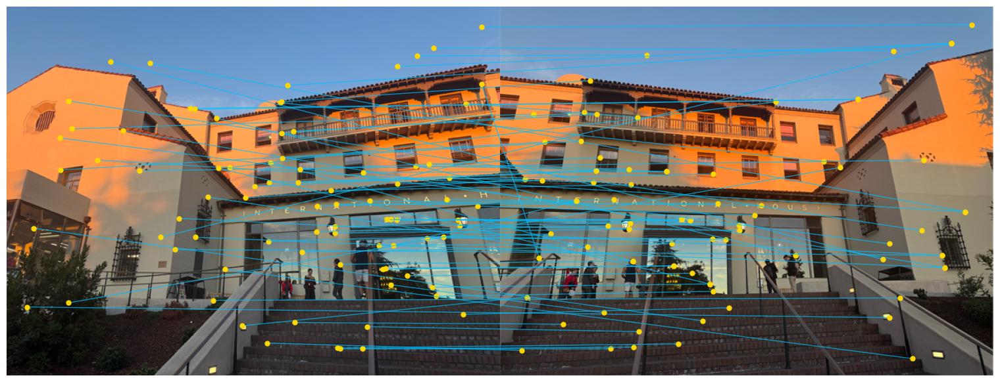

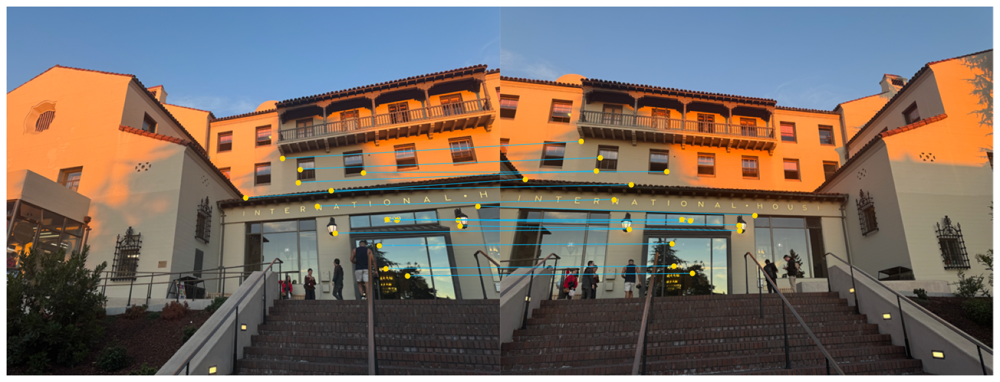

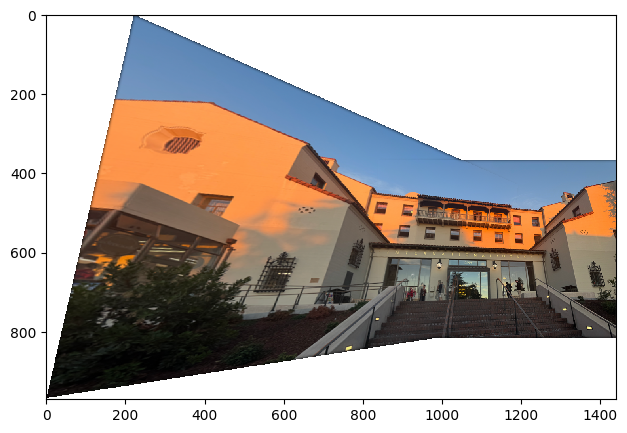

In [31]:
ihouse_morph = auto_morph('data/ihouse_left.png', 'data/ihouse_right.png', inlier_threshold=0.9)
save_image(ihouse_morph, 'auto_ihouse_morph')
skio.imshow(ihouse_morph)


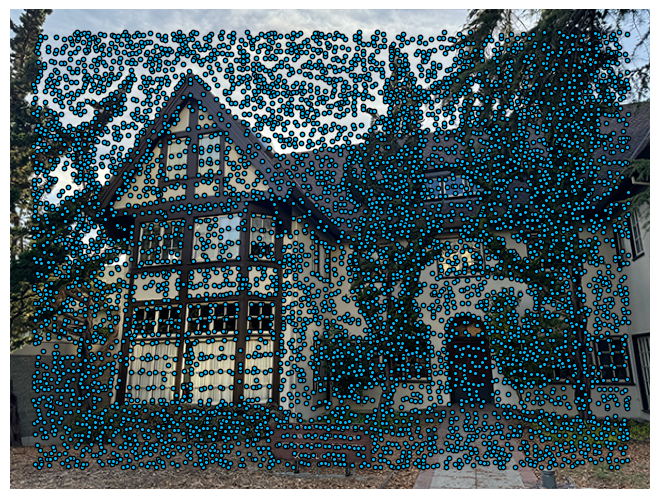

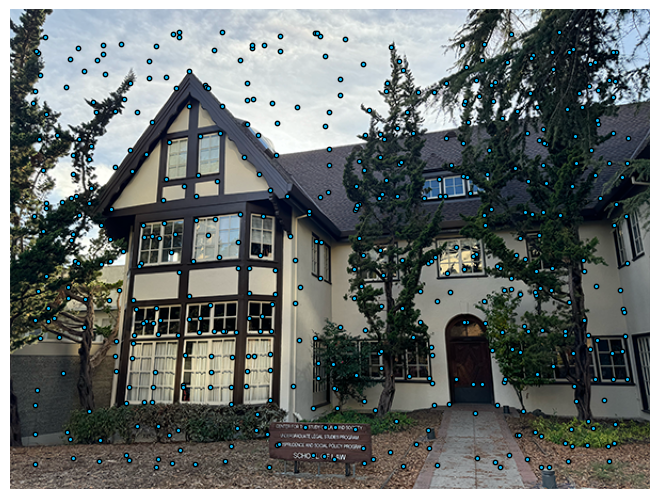

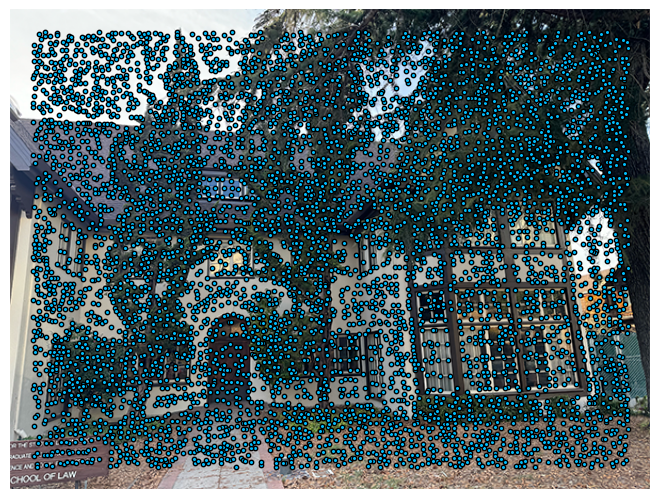

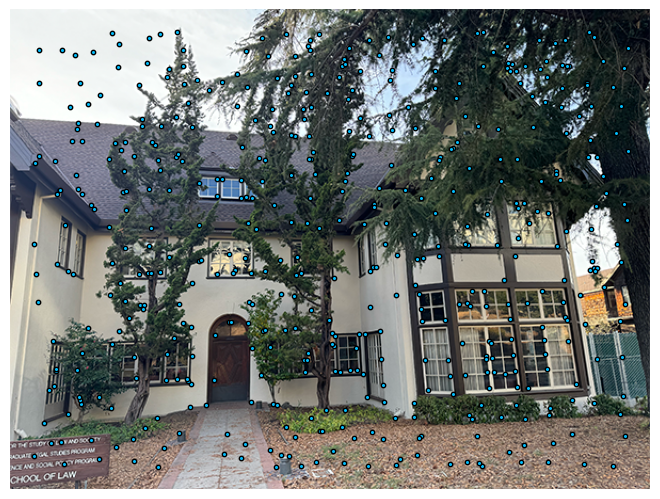

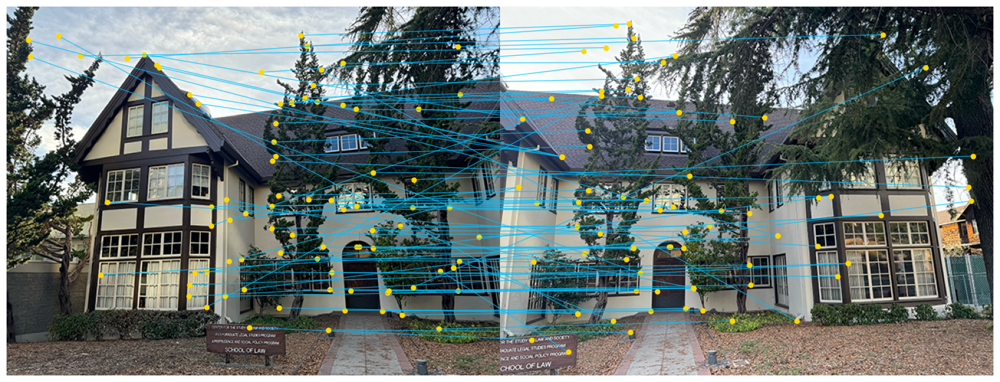

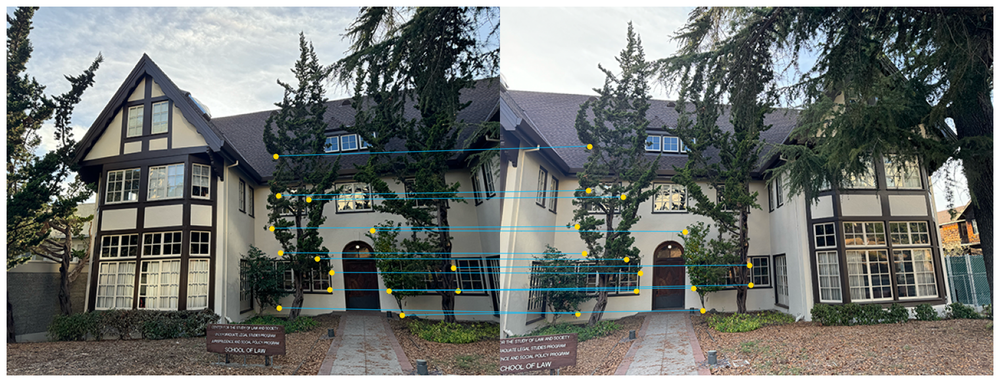

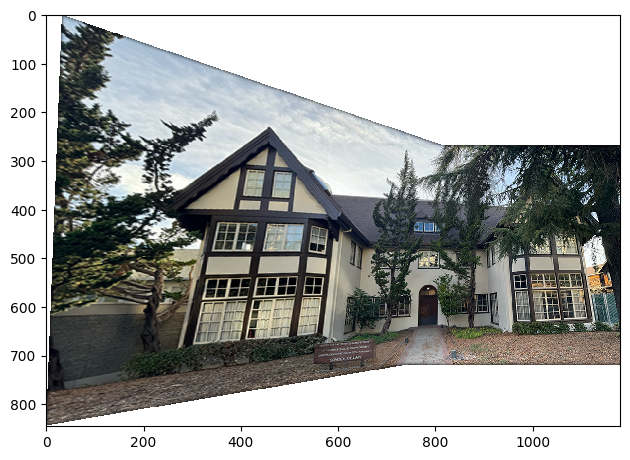

In [32]:
law_morph = auto_morph('data/law_left.png', 'data/law_right.png', inlier_threshold=0.55)
save_image(law_morph, 'auto_law_morph')
skio.imshow(law_morph)

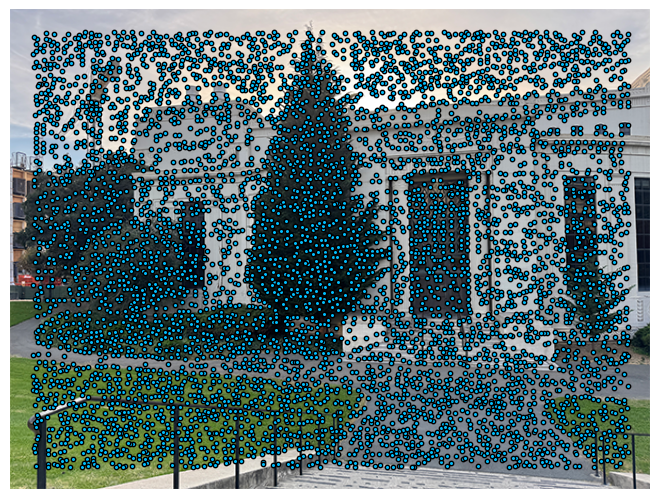

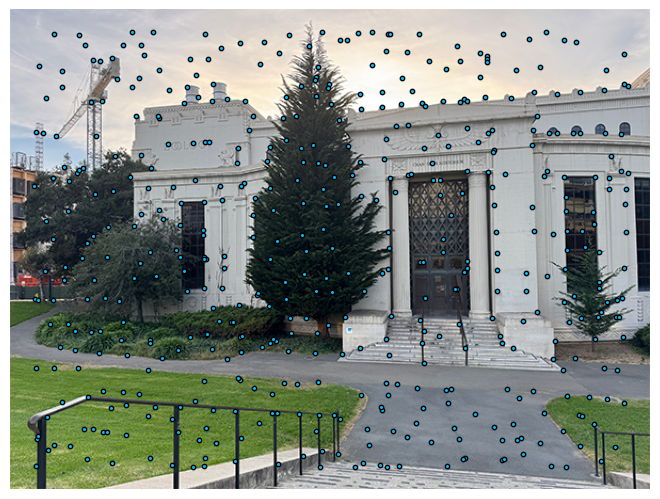

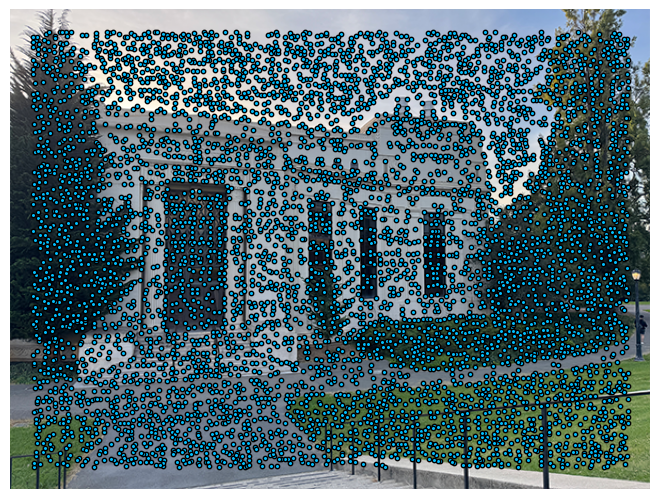

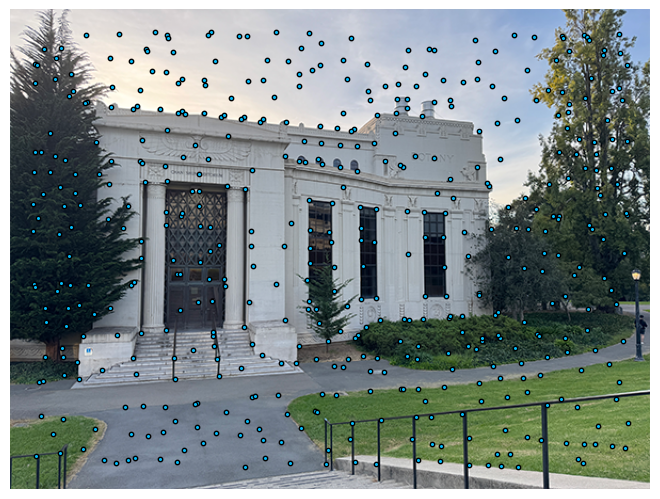

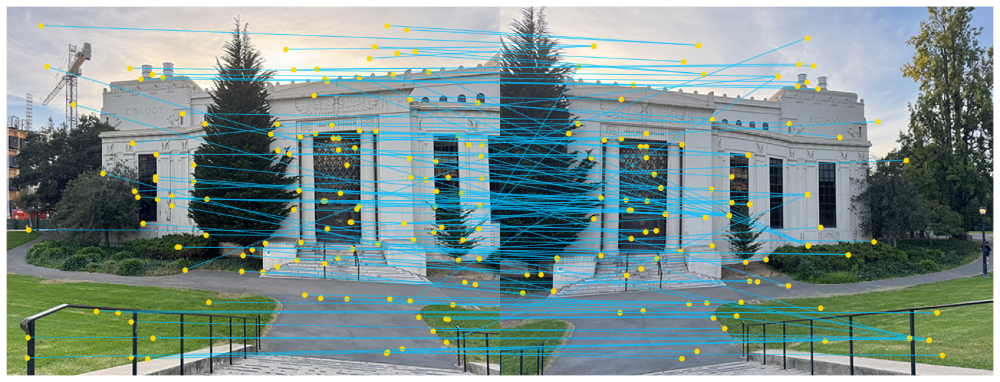

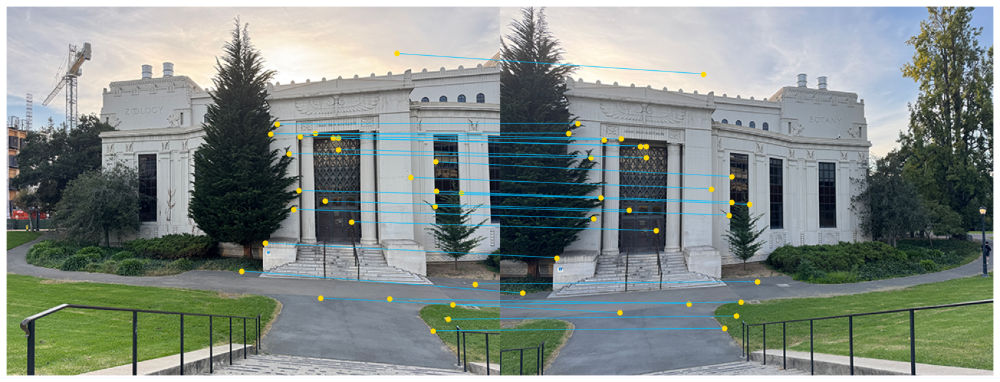

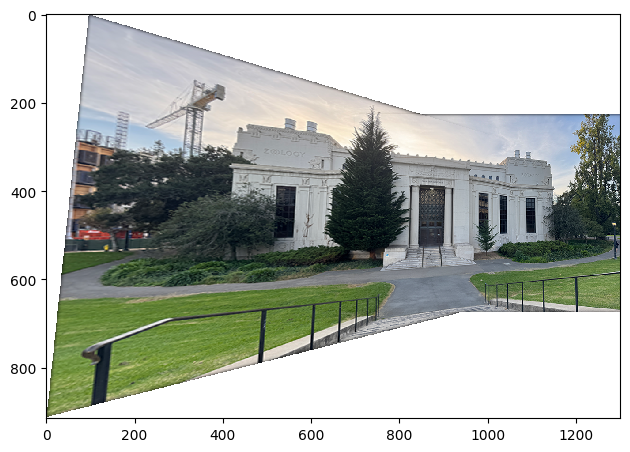

In [33]:
vlsb_morph = auto_morph('data/vlsb_left.png', 'data/vlsb_right.png')
save_image(vlsb_morph, 'auto_vlsb_morph')
skio.imshow(vlsb_morph)